In [1]:
import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import pickle

In [2]:
# Проверяем, доступны ли GPU
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [ ]:
# Загрузка DataFrame из файла
with open(r'../models/seg_maps_dataset.pkl', 'rb') as f:
    df = pickle.load(f)

In [4]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

X = df.drop(['Crystal', 'Stats', 'Pulce duration'], axis=1)

# Шаг 1: Преобразование строковых меток классов в числовые метки
label_encoder = LabelEncoder()

Stats = df['Stats']

y = df['Crystal']

y_encoded = label_encoder.fit_transform(y)

Diff_train, Diff_test, Stats_train, Stats_test, y_train, y_test = train_test_split(X, Stats, y_encoded, test_size=0.1, random_state=42)

In [5]:
# Преобразование матриц в numpy массив перед преобразованием в тензоры
Diff_train_matrices = np.array(Diff_train['Matrix'].tolist())
Diff_test_matrices = np.array(Diff_test['Matrix'].tolist())

Stats_train_matrices = np.array(Stats_train.tolist())
Stats_test_matrices = np.array(Stats_test.tolist())

# Преобразование данных в тензоры PyTorch
Diff_train_tensor = torch.FloatTensor(Diff_train_matrices)
Diff_train_tensor = Diff_train_tensor.unsqueeze(1)
Stats_train_tensor = torch.FloatTensor(Stats_train_matrices)
#Segmentation_Diff_train_tensor = Segmentation_Diff_train_tensor.unsqueeze(1)
y_train_tensor = torch.LongTensor(y_train)  # Используем LongTensor для целевых меток

Diff_test_tensor = torch.FloatTensor(Diff_test_matrices)
Diff_test_tensor = Diff_test_tensor.unsqueeze(1)
Stats_test_tensor = torch.FloatTensor(Stats_test_matrices)
#Segmentation_Diff_test_tensor = Segmentation_Diff_test_tensor.unsqueeze(1)
y_test_tensor = torch.LongTensor(y_test)

In [6]:
mean = torch.mean(Stats_train_tensor)
std = torch.std(Stats_train_tensor)

Stats_train_tensor = (Stats_train_tensor - mean) / std
Stats_test_tensor = (Stats_test_tensor - mean) / std

In [8]:
from torch.utils.data import TensorDataset, DataLoader, random_split

# Создание набора данных
train_dataset = TensorDataset(Diff_train_tensor, Stats_train_tensor, y_train_tensor)

test_dataset = TensorDataset(Diff_test_tensor, Stats_test_tensor, y_test_tensor)

# Создание DataLoader для каждой выборки
train_loader = DataLoader(train_dataset, batch_size=5, shuffle=True)

test_loader = DataLoader(test_dataset, batch_size=5, shuffle=False)

In [64]:
import torch.nn as nn

class ResidualBlock(nn.Module):
    def __init__(self, in_channels, out_channels, stride=1, upsample=None):
        super(ResidualBlock, self).__init__()
        # Устанавливаем output_padding=1 только при stride > 1
        output_padding = 1 if stride > 1 else 0
        self.conv1 = nn.ConvTranspose2d(
            in_channels, out_channels, kernel_size=3, 
            stride=stride, padding=1, output_padding=output_padding, bias=False
        )
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.ConvTranspose2d(
            out_channels, out_channels, kernel_size=3,
            stride=1, padding=1, bias=False
        )
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.upsample = upsample

    def forward(self, x):
        identity = x
        
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)
        
        out = self.conv2(out)
        out = self.bn2(out)

        if self.upsample is not None:
            identity = self.upsample(x)
            
        out += identity
        out = self.relu(out)
        return out
    


class ConvGenerator(nn.Module):
    def __init__(self, noise_dim, stats_dim, embedding_crystal):
        super(ConvGenerator, self).__init__()

        # Условное встраивание (embedding)
        self.embedding_crystal = embedding_crystal

        # Замораживаем все параметры эмбеддинга
        for param in self.embedding_crystal.parameters():
            param.requires_grad = False

        # Общая размерность условия: embedding_dim (crystal) + stats_dim (статистика)
        condition_dim = embedding_crystal.embedding_dim + stats_dim   #Размерность параметра статистики 1

        self.fc = nn.Linear(noise_dim + condition_dim, 512 * 7 * 15)
        
        # Initial block
        self.init_conv = nn.Sequential(
            nn.ConvTranspose2d(512, 512, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True)
        )
        
        # Residual blocks (с учётом исправленного output_padding)
        self.layer1 = self._make_layer(512, 256, stride=2)
        self.layer2 = self._make_layer(256, 128, stride=2)
        self.layer3 = self._make_layer(128, 64, stride=2)
        self.layer4 = self._make_layer(64, 32, stride=2)
        
        # Final layers
        self.final = nn.Sequential(
            nn.BatchNorm2d(32),  # Добавьте это
            nn.Conv2d(32, 1, kernel_size=1, stride=1),
            nn.Tanh()
        )

    def _make_layer(self, in_channels, out_channels, stride):
        upsample = nn.Sequential(
            nn.ConvTranspose2d(
                in_channels, out_channels,
                kernel_size=1, stride=stride, 
                output_padding=1,  # Для stride=2 допустимо
                bias=False),
            nn.BatchNorm2d(out_channels)
        )
        return nn.Sequential(
            ResidualBlock(
                in_channels, out_channels,
                stride=stride, upsample=upsample
            ),
            ResidualBlock(out_channels, out_channels, stride=1)  # Здесь stride=1, output_padding=0
        )

    def forward(self, noise, crystal, stats):
        
        # 1. Преобразуем crystal в embedding
        crystal_embedded = self.embedding_crystal(crystal)  # [batch_size, embedding_dim]
        # 2. Объединяем с stats (предполагаем, что stats уже [batch_size, stats_dim])
        condition = torch.cat([crystal_embedded, stats], dim=1)  # [batch_size, embedding_dim + stats_dim]

        x = torch.cat([noise, condition], dim=1)
        x = self.fc(x).view(-1, 512, 7, 15)
        #print(f'fc layer size: {x.size()}')
        x = self.init_conv(x)
        x = nn.functional.pad(x, (0, 0, 1, 0))
        #print(f'init_conv layer size: {x.size()}')
        x = self.layer1(x)
        x = nn.functional.pad(x, (0, 0, 1, 0))
        #print(f'layer1 layer size: {x.size()}')
        x = self.layer2(x)
        #print(f'layer2 layer size: {x.size()}')
        x = self.layer3(x)
        x = nn.functional.pad(x, (0, 0, 1, 0))
        #print(f'layer3 layer size: {x.size()}')
        x = self.layer4(x)
        #print(f'layer4 layer size: {x.size()}')
        x = self.final(x)
        #print(f'final layer size: {x.size()}')
        return x[:, :, :250, :480]

In [ ]:
import torch.nn as nn

class ResidualBlock(nn.Module):
    def __init__(self, in_channels, out_channels, stride=1, upsample=None):
        super(ResidualBlock, self).__init__()
        
        self.conv1 = nn.Conv2d(
            in_channels, out_channels, kernel_size=3, 
            stride=1, padding=1, bias=False
        )
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(
            out_channels, out_channels, kernel_size=3,
            stride=1, padding=1, bias=False
        )
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.upsample = upsample

    def forward(self, x):
   
        if self.upsample is not None:
            x = self.upsample(x)
        
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)
        
        out = self.conv2(out)
        out = self.bn2(out)
            
        out += x
        out = self.relu(out)
        return out
    

class ConvGenerator(nn.Module):
    def __init__(self, noise_dim, stats_dim, embedding_crystal):
        super(ConvGenerator, self).__init__()

        # Условное встраивание (embedding)
        self.embedding_crystal = embedding_crystal

        # Замораживаем все параметры эмбеддинга
        for param in self.embedding_crystal.parameters():
            param.requires_grad = False

        # Общая размерность условия: embedding_dim (crystal) + stats_dim (статистика)
        condition_dim = embedding_crystal.embedding_dim + stats_dim   #Размерность параметра статистики 1

        self.fc = nn.Linear(noise_dim + condition_dim, 512 * 7 * 15)
        
        # Initial block
        self.init_conv = nn.Sequential(
            nn.Conv2d(512, 512, kernel_size=1, stride=1),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True)
        )
        
        # Residual blocks (с учётом исправленного output_padding)
        self.layer1 = self._make_layer(512, 256, stride=2)
        self.layer2 = self._make_layer(256, 128, stride=2)
        self.layer3 = self._make_layer(128, 64, stride=2)
        self.layer4 = self._make_layer(64, 32, stride=2)
        
        # Final layers
        self.final = nn.Sequential(
            nn.BatchNorm2d(32),  # Добавьте это
            nn.LeakyReLU(0.2),  # Или nn.ReLU()
            nn.ConvTranspose2d(32, 1, kernel_size=4, stride=2, padding=1),
            nn.Tanh()
        )

    def _make_layer(self, in_channels, out_channels, stride):
        upsample = nn.Sequential(
            nn.ConvTranspose2d(
                in_channels, out_channels,
                kernel_size=1, stride=stride, 
                output_padding=1,  # Для stride=2 допустимо
                bias=False),
            nn.BatchNorm2d(out_channels)
        )
        return nn.Sequential(
            ResidualBlock(
                out_channels, out_channels,
                stride=stride, upsample=upsample
            ),
            ResidualBlock(out_channels, out_channels, stride=1)  # Здесь stride=1, output_padding=0
        )

    def forward(self, noise, crystal, stats):
        
        # 1. Преобразуем crystal в embedding
        crystal_embedded = self.embedding_crystal(crystal)  # [batch_size, embedding_dim]
        # 2. Объединяем с stats (предполагаем, что stats уже [batch_size, stats_dim])
        condition = torch.cat([crystal_embedded, stats], dim=1)  # [batch_size, embedding_dim + stats_dim]

        x = torch.cat([noise, condition], dim=1)
        x = self.fc(x).view(-1, 512, 7, 15)
        x = self.init_conv(x)
        x = self.layer1(x)
        x = nn.functional.pad(x, (0, 0, 1, 0))
        x = self.layer2(x)
        x = nn.functional.pad(x, (0, 0, 1, 0))
        x = self.layer3(x)
        x = self.layer4(x)
        x = nn.functional.pad(x, (0, 0, 1, 0))
        x = self.final(x)
        return x[:, :, :250, :480]

In [65]:
import torchvision

class ResNetDiscriminator(nn.Module):
    def __init__(self, stats_dim, input_shape, embedding_crystal):
        super(ResNetDiscriminator, self).__init__()

        self.embedding_crystal = embedding_crystal
        
        # Замораживаем все параметры эмбеддинга
        for param in self.embedding_crystal.parameters():
            param.requires_grad = False

        # Размерность условия: embedding_dim + stats_dim
        condition_dim = embedding_crystal.embedding_dim + stats_dim
        
        # Condition processing
        self.condition_fc = nn.Sequential(
            nn.Linear(condition_dim, 128),
            nn.ReLU(),
            nn.Linear(128, input_shape[0] * input_shape[1] * input_shape[2]),
            nn.Unflatten(1, (1, input_shape[1], input_shape[2]))
        )
        
        # Modified ResNet-18 (input channels = 2)
        self.resnet = torchvision.models.resnet18(pretrained=False)
        self.resnet.conv1 = nn.Conv2d(
            2, 64, kernel_size=7, stride=2, padding=3, bias=False)
        
        # Replace final layers
        self.resnet.fc = nn.Sequential(
            nn.Linear(512, 1),
            nn.Sigmoid()
        )

    def forward(self, image, crystal, stats):
        crystal_embedded = self.embedding_crystal(crystal)  # Общий слой!
        condition = torch.cat([crystal_embedded, stats], dim=1)
        cond = self.condition_fc(condition)
        x = torch.cat([image, cond], dim=1)
        x = self.resnet(x)
        return x
    

# Пример сверточного дискриминатора
class UglyDiscriminator(nn.Module):
    def __init__(self, stats_dim, input_shape, embedding_crystal):
        super(UglyDiscriminator, self).__init__()

        self.embedding_crystal = embedding_crystal

        # Замораживаем все параметры эмбеддинга
        for param in self.embedding_crystal.parameters():
            param.requires_grad = False

        # Размерность условия: embedding_dim + stats_dim
        condition_dim = embedding_crystal.embedding_dim + stats_dim
        
        # Полносвязный слой для встраивания condition
        self.fc1 = nn.Linear(condition_dim, input_shape[0] * input_shape[1] * input_shape[2])

        # Сверточные слои для классификации
        self.main = nn.Sequential(
            nn.Conv2d(2, 64, kernel_size=4, stride=2, padding=1),  # 250x480 -> 125x240
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1), # 125x240 -> 62x120
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1), # 62x120 -> 31x60
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(256, 1, kernel_size=4, stride=2, padding=1),   # 31x60 -> 15x30
            nn.LeakyReLU(0.2, inplace=True),
        )
        
        # Полносвязный слой для классификации реальное/сгенерированное
        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(15 * 30, 1),
            nn.Sigmoid()
        )

    def forward(self, image, crystal, stats):
        crystal_embedded = self.embedding_crystal(crystal)  # Общий слой!
        condition = torch.cat([crystal_embedded, stats], dim=1)
        # Преобразование condition в форму для конкатенации с изображением
        cond = self.fc1(condition).view(-1, 1, image.shape[2], image.shape[3])
        x = torch.cat([image, cond], dim=1)  # Конкатенация по канальному измерению
        #print(x.size())
        x = self.main(x)
        #print(x.size())
        x = self.classifier(x)  # Вычисление итоговой вероятности
        return x

In [85]:
class CrystalEmbeddingLayer(nn.Module):
    def __init__(self, embedding_dict, embedding_dim):
        """
        Args:
            embedding_dict (dict): Словарь {class_id: avg_embedding}
            embedding_dim (int): Размерность эмбеддингов
        """
        super().__init__()

        self.embedding_dim = embedding_dim
        
        # Создаем упорядоченный список классов
        self.classes = sorted(embedding_dict.keys())
        
        # Инициализируем матрицу эмбеддингов
        embedding_matrix = torch.zeros((len(self.classes), embedding_dim))
        
        # Заполняем матрицу из словаря
        for class_id in self.classes:
            embedding_matrix[class_id] = torch.tensor(embedding_dict[class_id])
        
        # Регистрируем как обучаемый параметр (или замораживаем)
        self.embedding = nn.Embedding.from_pretrained(embedding_matrix, freeze=False)
        
    def forward(self, class_labels):
        """
        Args:
            class_labels (torch.Tensor): Тензор меток [batch_size, 1]
        Returns:
            torch.Tensor: Тензор эмбеддингов [batch_size, embedding_dim]
        """
        # Преобразуем [batch_size, 1] -> [batch_size]
        if class_labels.dim() == 2 and class_labels.size(1) == 1:
            class_labels = class_labels.squeeze(1)

        return self.embedding(class_labels)

In [86]:
# Параметры
noise_dim = 512
num_crystal_types = 30  # Количество типов кристаллов
stats_dim = 1           # Размерность статистики (например, 1, если stats — скаляр)
embedding_dim = 512   # Размерность эмбеддинга

#embedding_crystal = nn.Embedding(num_crystal_types, embedding_dim).to(device)
embedding_crystal = torch.load('crystal_embedding_layer_512.pth')

In [87]:
# Создаём генератор и дискриминатор
generator = ConvGenerator(
    noise_dim=noise_dim,
    stats_dim=stats_dim,
    embedding_crystal=embedding_crystal
).to(device)

discriminator = UglyDiscriminator(
    stats_dim=stats_dim,
    input_shape=(1, 250, 480),
    embedding_crystal=embedding_crystal
).to(device)

In [83]:
for real_images, stats, tags in train_loader:
    real_images = real_images.to(device)
    stats = stats.to(device)
    tags = tags.to(device) 
    noise = torch.randn(real_images.size(0), noise_dim).to(device)

    stats = stats.unsqueeze(1)  # Преобразует [batch_size] в [batch_size, 1]
    fake_images = generator(noise, tags, stats)

    print(fake_images.size())

    out = discriminator(fake_images.detach(), tags, stats)
    print(out.size())

    break

AttributeError: 'CrystalEmbeddingLayer' object has no attribute 'Relu'

In [70]:
criterion = torch.nn.BCELoss()

# Параметры оптимизаторов
lr = 0.0001  # Скорость обучения
beta1 = 0.5  # Параметры для Adam, beta1 = 0.5 часто используется в GAN

# Create optimizers
optimizer = {
    "discriminator": torch.optim.Adam(discriminator.parameters(), 
                                        lr=lr, betas=(0.5, 0.999)),
    "generator": torch.optim.Adam(generator.parameters(),
                                    lr=lr, betas=(0.5, 0.999))
}

In [71]:
def weights_init(m):
    # Пропускаем эмбеддинг-слои
    if isinstance(m, (nn.Embedding, nn.EmbeddingBag)):
        return
        
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.Linear):
        nn.init.normal_(m.weight, mean=0.0, std=0.02)
        if m.bias is not None:
            nn.init.constant_(m.bias, 0)

# Применяем только к незамороженным параметрам
def init_non_embedding_weights(model):
    for name, module in model.named_children():
        if name != 'embedding_crystal':  # Пропускаем наш эмбеддинг
            module.apply(weights_init)

init_non_embedding_weights(generator)
init_non_embedding_weights(discriminator)

In [72]:
# Проверим, что эмбеддинг заморожен
for name, param in discriminator.named_parameters():
    print(f"{name}: requires_grad={param.requires_grad}")

embedding_crystal.embedding.weight: requires_grad=False
fc1.weight: requires_grad=True
fc1.bias: requires_grad=True
main.0.weight: requires_grad=True
main.0.bias: requires_grad=True
main.2.weight: requires_grad=True
main.2.bias: requires_grad=True
main.3.weight: requires_grad=True
main.3.bias: requires_grad=True
main.5.weight: requires_grad=True
main.5.bias: requires_grad=True
main.6.weight: requires_grad=True
main.6.bias: requires_grad=True
main.8.weight: requires_grad=True
main.8.bias: requires_grad=True
classifier.1.weight: requires_grad=True
classifier.1.bias: requires_grad=True


In [48]:
def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.Linear):
        nn.init.normal_(m.weight, mean=0.0, std=0.02)
        if m.bias is not None:
            nn.init.constant_(m.bias, 0)

# Инициализация весов моделей
generator.apply(weights_init)
discriminator.apply(weights_init)

UglyDiscriminator(
  (embedding_crystal): CrystalEmbeddingLayer(
    (embedding): Embedding(30, 512)
  )
  (fc1): Linear(in_features=513, out_features=120000, bias=True)
  (main): Sequential(
    (0): Conv2d(2, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (9): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (classifier): Sequential(
    (0): Flatten(start_dim=1, end_dim=-1)
    (1): Linear(in_features=450, out_fea

In [73]:
# Параметры для обучения
num_epochs = 40
history_g = []
history_d = []

generator.to(device)
discriminator.to(device)

UglyDiscriminator(
  (embedding_crystal): CrystalEmbeddingLayer(
    (embedding): Embedding(30, 512)
  )
  (fc1): Linear(in_features=513, out_features=120000, bias=True)
  (main): Sequential(
    (0): Conv2d(2, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (9): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (classifier): Sequential(
    (0): Flatten(start_dim=1, end_dim=-1)
    (1): Linear(in_features=450, out_fea

In [74]:
from tqdm import tqdm

# Losses & scores
losses_g = []
losses_d = []
real_scores = []
fake_scores = []

for epoch in range(num_epochs):
    loss_d_per_epoch = []
    loss_g_per_epoch = []
    real_score_per_epoch = []
    fake_score_per_epoch = []
    for real_images, stats, crystals in tqdm(train_loader, desc=f"Epoch {epoch} Train", leave=False):
        real_images = real_images.to(device)
        stats = stats.unsqueeze(1)  # Преобразует [batch_size] в [batch_size, 1]
        stats = stats.to(device)
        crystals = crystals.to(device)

        # Обучение дискриминатора
        # Оччистка градиентов для дискриминатора
        optimizer["discriminator"].zero_grad()

        #generator(noise, tags, stats)
        #discriminator(fake_images.detach(), tags, stats)

        # Pass real images through discriminator
        real_preds = discriminator(real_images, tags, stats)
        
        real_targets = torch.ones(real_images.size(0), 1, device=device)
        real_loss = criterion(real_preds, real_targets)
        cur_real_score = torch.mean(real_preds).item()
        
        # Generate fake images
        latent = torch.randn(real_images.size(0), noise_dim).to(device)
        fake_images =  generator(latent, tags, stats)


        # Pass fake images through discriminator
        fake_targets = torch.zeros(fake_images.size(0), 1, device=device)
        fake_preds = discriminator(fake_images, tags, stats)

        fake_loss = criterion(fake_preds, fake_targets)
        cur_fake_score = torch.mean(fake_preds).item()

        real_score_per_epoch.append(cur_real_score)
        fake_score_per_epoch.append(cur_fake_score)

        # Update discriminator weights
        loss_d = real_loss + fake_loss
        loss_d.backward(retain_graph=True)
        #loss_d.backward()
        optimizer["discriminator"].step()
        loss_d_per_epoch.append(loss_d.item())


        # Train generator
        # Clear generator gradients
        optimizer["generator"].zero_grad()
        
        # Generate fake images
        latent = torch.randn(real_images.size(0), noise_dim).to(device)
        fake_images = generator(latent, tags, stats)

        # Try to fool the discriminator
        preds = discriminator(fake_images, tags, stats)
        targets = torch.ones(real_images.size(0), 1, device=device)
        loss_g = criterion(preds, targets)
        
        # Update generator weights
        loss_g.backward()
        optimizer["generator"].step()
        loss_g_per_epoch.append(loss_g.item())

    # Record losses & scores
    losses_g.append(np.mean(loss_g_per_epoch))
    losses_d.append(np.mean(loss_d_per_epoch))
    real_scores.append(np.mean(real_score_per_epoch))
    fake_scores.append(np.mean(fake_score_per_epoch))

    print(f'Epoch [{epoch}/{num_epochs}], d_loss: {losses_d[-1]}, g_loss: {losses_g[-1]},  real_score: {real_scores[-1]}, fake_score: {fake_scores[-1]}')

Epoch [0/40], d_loss: 1.4158094632036893, g_loss: 0.7454765656112153,  real_score: 0.49716224231653744, fake_score: 0.5080639652815866


Epoch [1/40], d_loss: 1.3876422748521522, g_loss: 0.7144613965977857,  real_score: 0.5001258855156693, fake_score: 0.500325268663374


Epoch [2/40], d_loss: 1.3869334569683782, g_loss: 0.7154928404423926,  real_score: 0.5006815628780995, fake_score: 0.49974238670166626


Epoch [3/40], d_loss: 1.3852323326799605, g_loss: 0.7331583668236379,  real_score: 0.5024391518054921, fake_score: 0.49855331641932327


Epoch [4/40], d_loss: 1.310918038274035, g_loss: 0.9826298325242083,  real_score: 0.5324267341904803, fake_score: 0.46939927659192937


Epoch [5/40], d_loss: 1.0921529432137806, g_loss: 1.45955434312791,  real_score: 0.6121093859252187, fake_score: 0.38877254671900086


KeyboardInterrupt: 

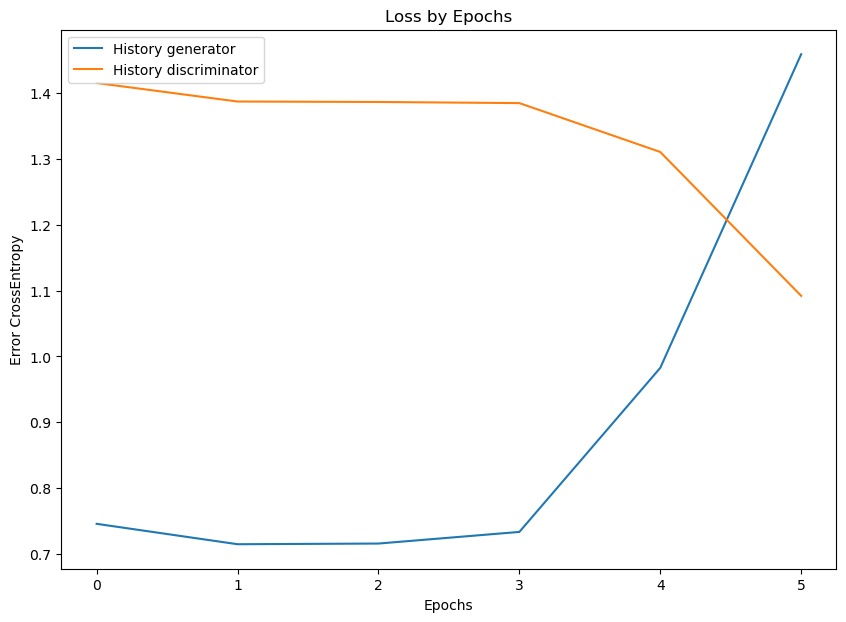

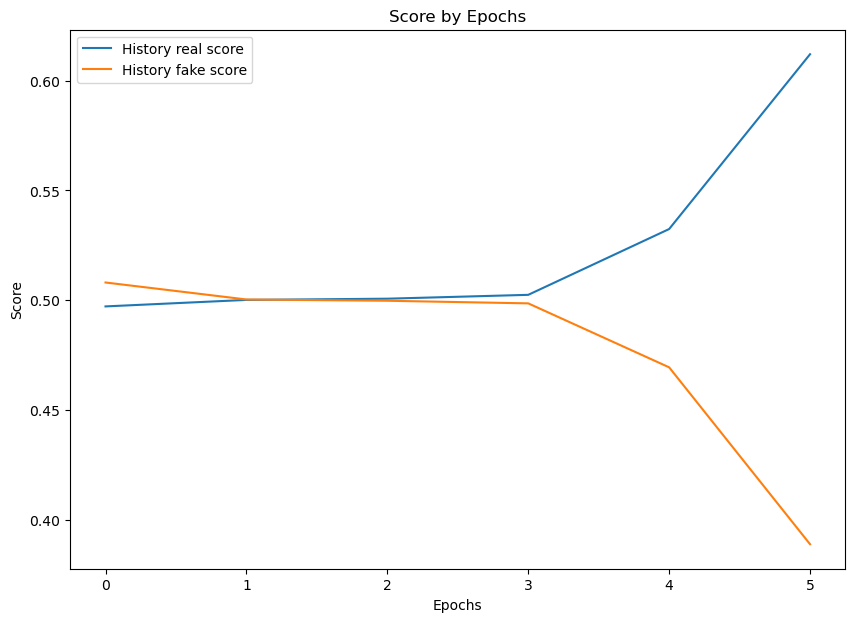

In [75]:
plt.figure(figsize=(10, 7))
plt.plot(losses_g, label = 'History generator')
plt.plot(losses_d, label = 'History discriminator')
plt.title('Loss by Epochs')
plt.ylabel('Error CrossEntropy')
plt.xlabel('Epochs')
plt.legend()
plt.show()

plt.figure(figsize=(10, 7))
plt.plot(real_scores, label = 'History real score')
plt.plot(fake_scores, label = 'History fake score')
plt.title('Score by Epochs')
plt.ylabel('Score')
plt.xlabel('Epochs')
plt.legend()
plt.show()

In [76]:
def plot_grad_flow(named_parameters):
    ave_grads = []
    layers = []
    for n, p in named_parameters:
        if(p.requires_grad) and ("bias" not in n):
            layers.append(n)
            ave_grads.append(p.grad.abs().mean().cpu())
    plt.plot(ave_grads, alpha=0.3, color="b")
    plt.hlines(0, 0, len(ave_grads)+1, linewidth=1, color="k" )
    plt.xticks(range(0,len(ave_grads), 1), layers, rotation="vertical")
    plt.xlim(xmin=0, xmax=len(ave_grads))
    plt.xlabel("Layers")
    plt.ylabel("average gradient")
    plt.title("Gradient flow")
    plt.grid(True)
    plt.show()

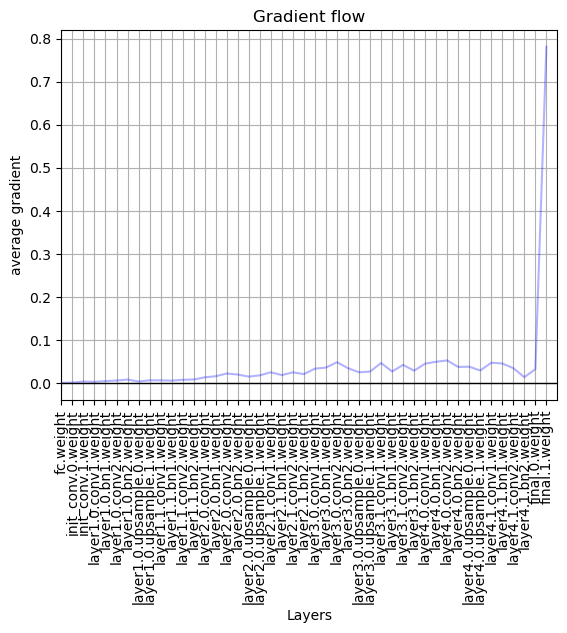

AttributeError: 'NoneType' object has no attribute 'abs'

In [77]:
plot_grad_flow(generator.named_parameters())
plot_grad_flow(discriminator.named_parameters())

In [78]:
#array([1.e+07, 2.e+07, 5.e+07, 1.e+08, 2.e+08, 5.e+08])
maxStats = 5.e+08
minI = max(df['Pulce duration'].unique())

df_test = df.loc[((df['Stats'] == maxStats) & (df['Pulce duration'] == minI))]
df_test = df_test.reset_index(drop= True)

Crystal_tags = df_test['Crystal']

Crystal_tags_encoded = label_encoder.fit_transform(Crystal_tags)

Crystal_tags_encoded = torch.LongTensor(Crystal_tags_encoded)
Crystal_tags_encoded = Crystal_tags_encoded.to(device)

#segment_df_test = segment_df.loc[((segment_df['Stats'] == maxStats) & (segment_df['Pulce duration'] == minI))]
#segment_df_test = segment_df_test.reset_index(drop= True)

# Преобразование матриц в numpy массив перед преобразованием в тензоры
df_test_matrices = np.array(df_test['Matrix'].tolist())

# Преобразование данных в тензоры PyTorch
df_test_tensor = torch.FloatTensor(df_test_matrices)
df_test_tensor = df_test_tensor.unsqueeze(1)

#Segmenation_df_test_tensor = torch.FloatTensor(Segmenation_df_test_matrices)
#Segmenation_df_test_tensor = Segmenation_df_test_tensor.unsqueeze(1)

df_test_tensor = df_test_tensor.to(device)
#Segmenation_df_test_tensor.size()
df_test_tensor.size()

df_test_tensor = df_test_tensor.to(device)

[0]


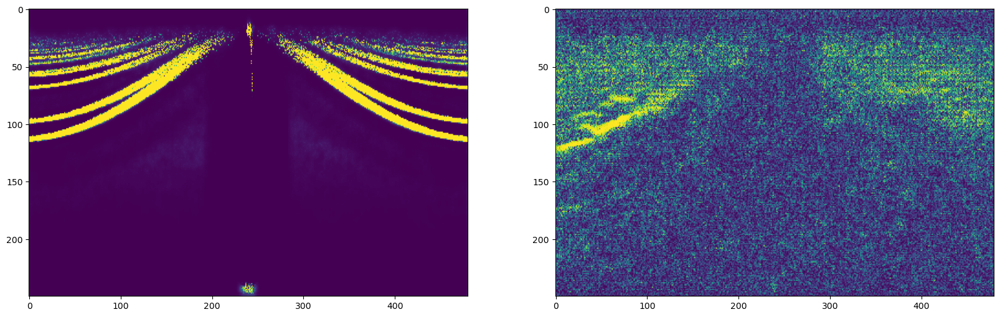

[1]


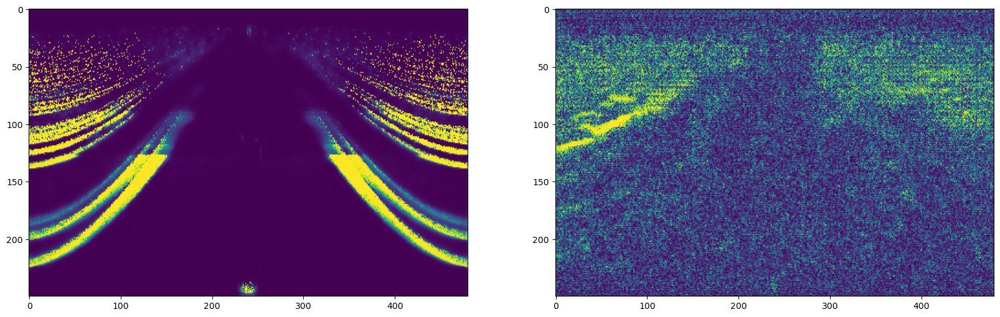

[2]


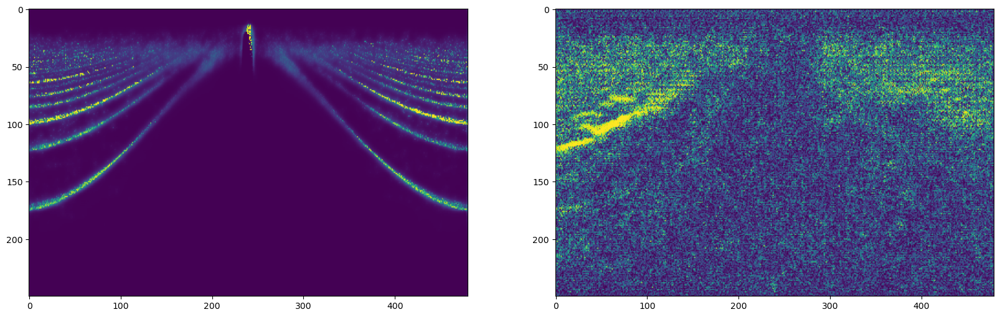

[3]


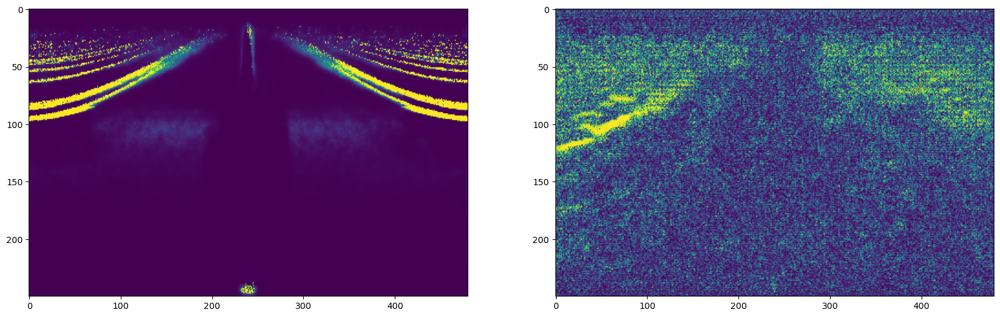

[4]


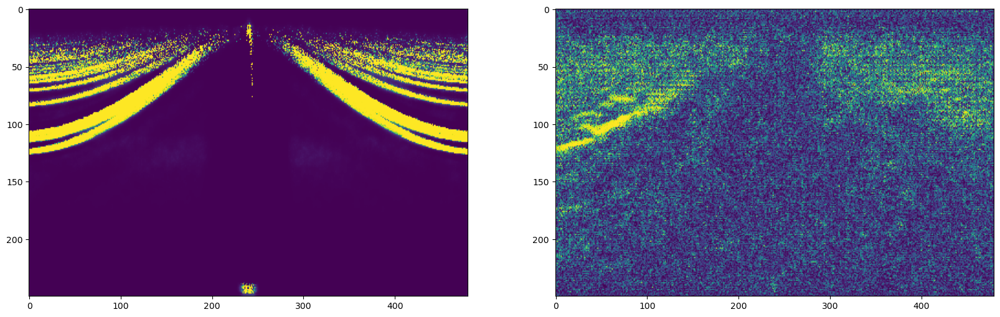

[5]


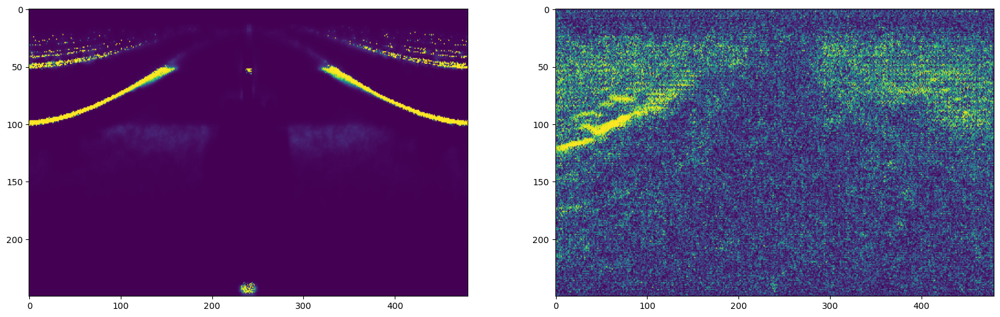

[6]


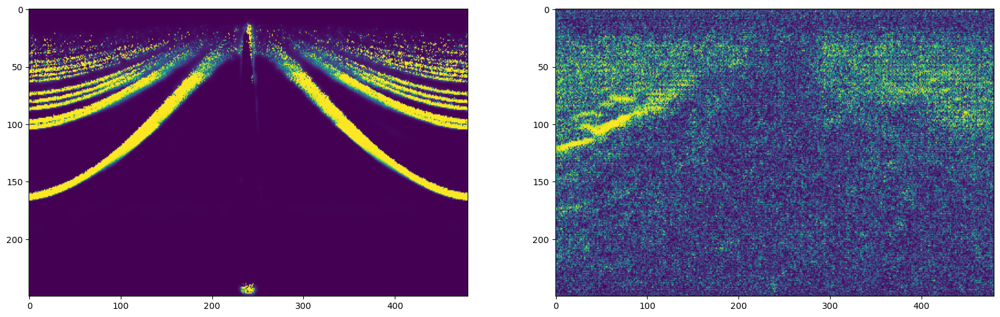

[7]


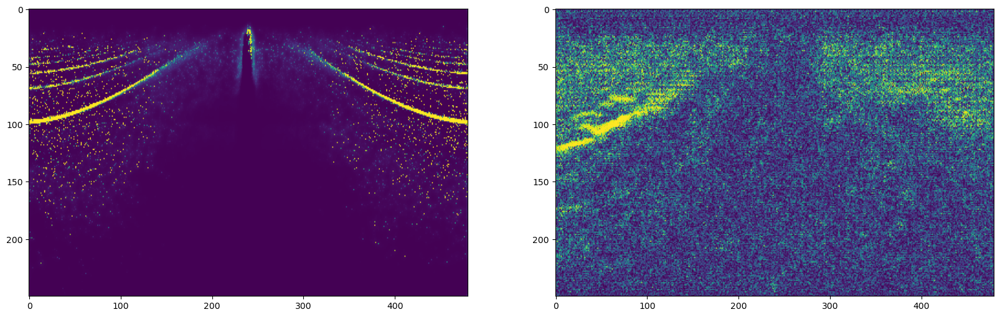

[8]


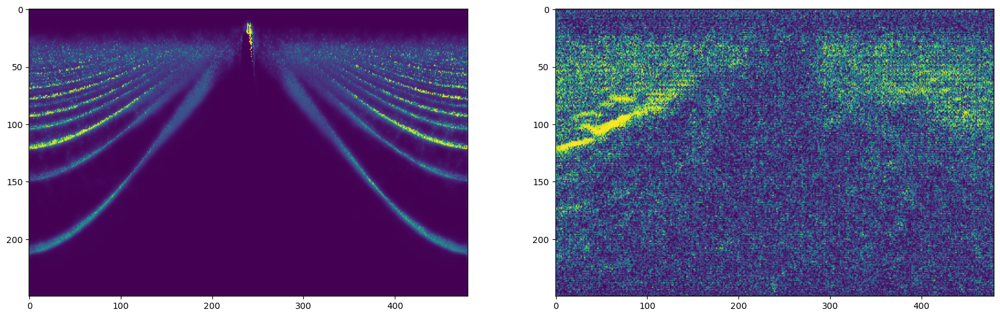

[9]


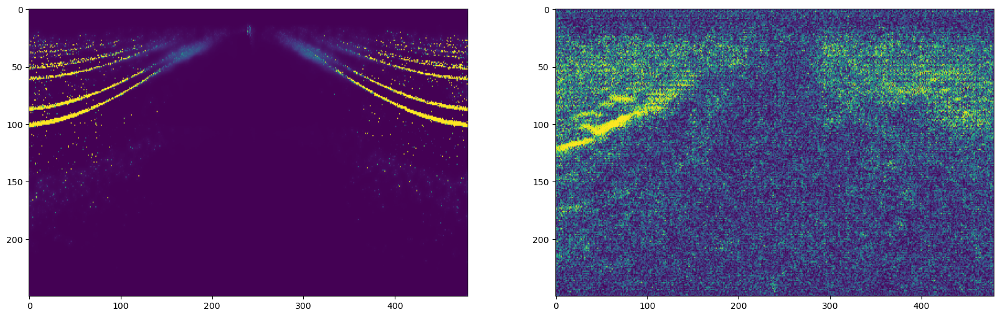

[10]


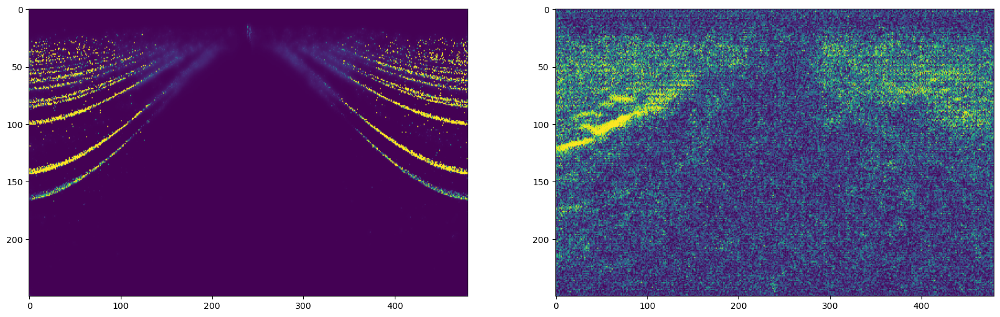

[11]


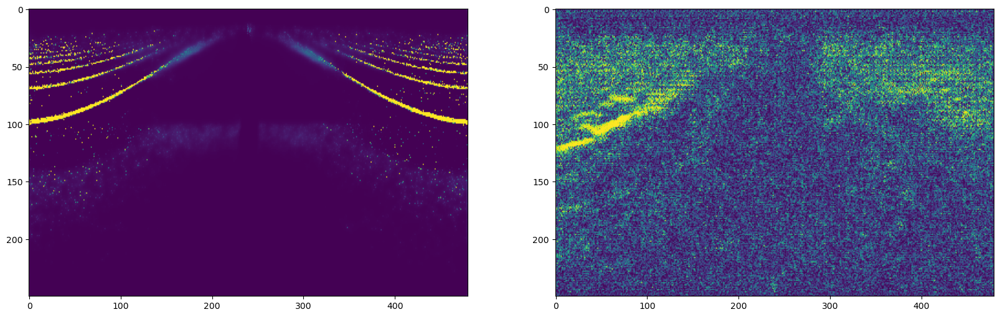

[12]


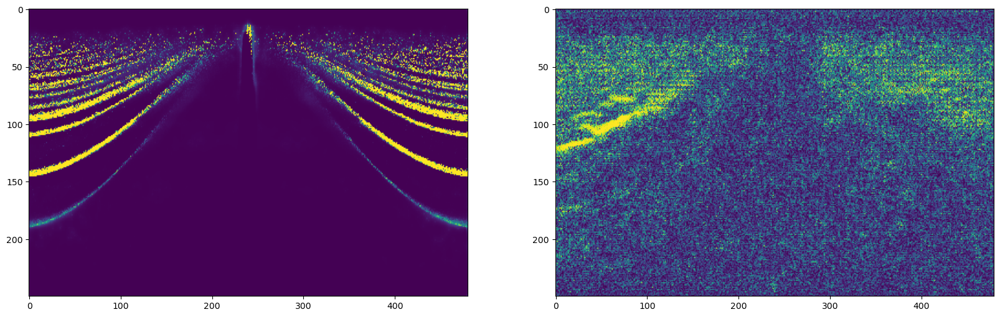

[13]


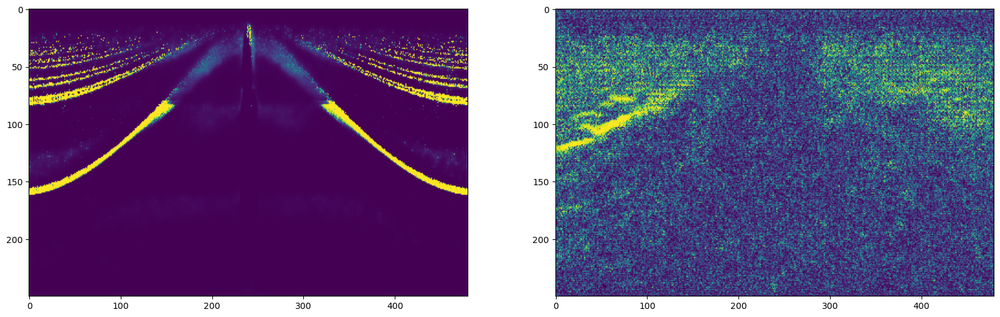

[14]


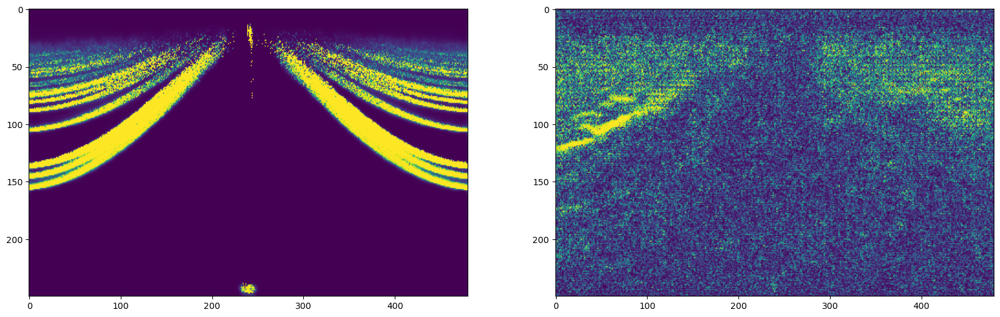

[15]


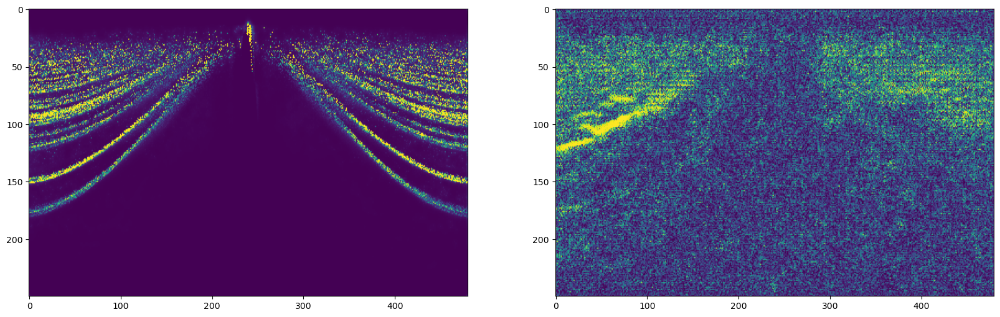

[16]


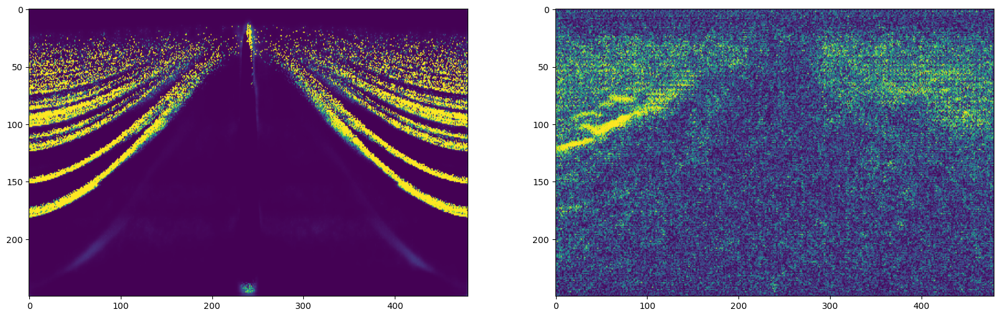

[17]


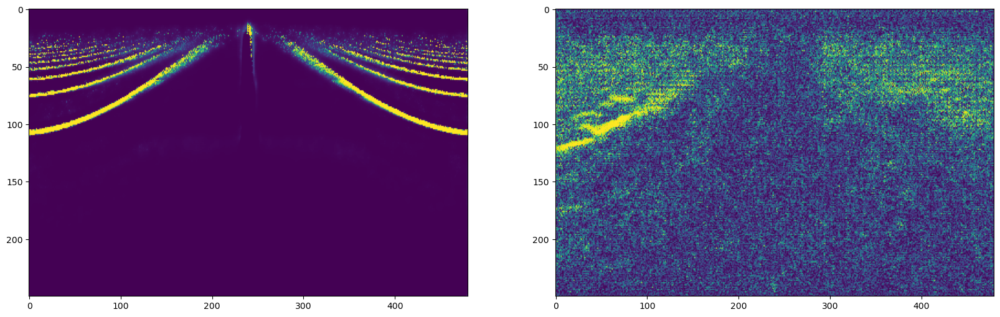

[18]


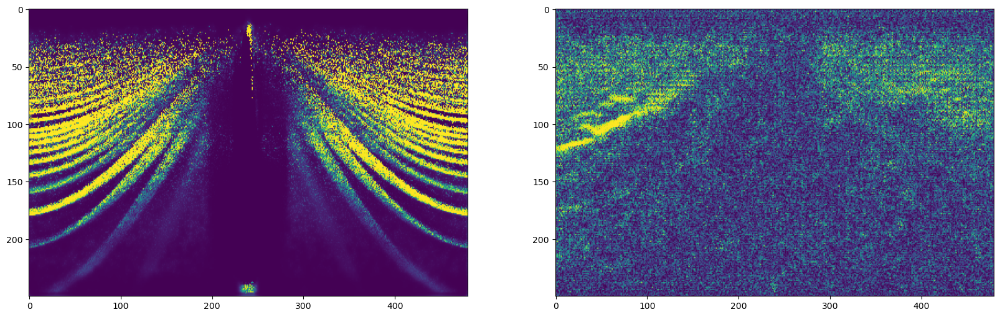

[19]


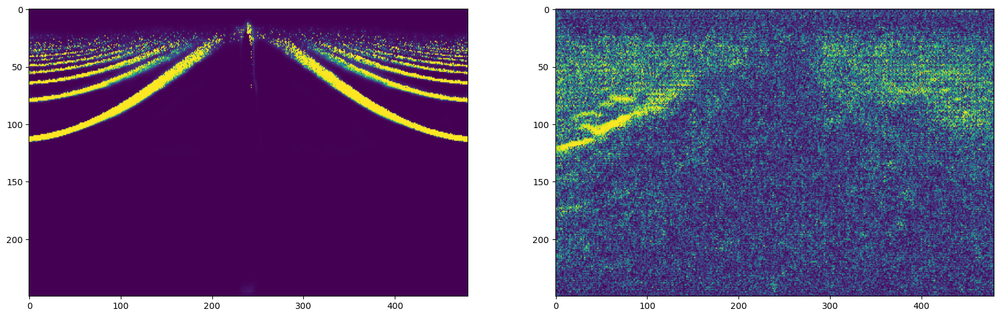

[20]


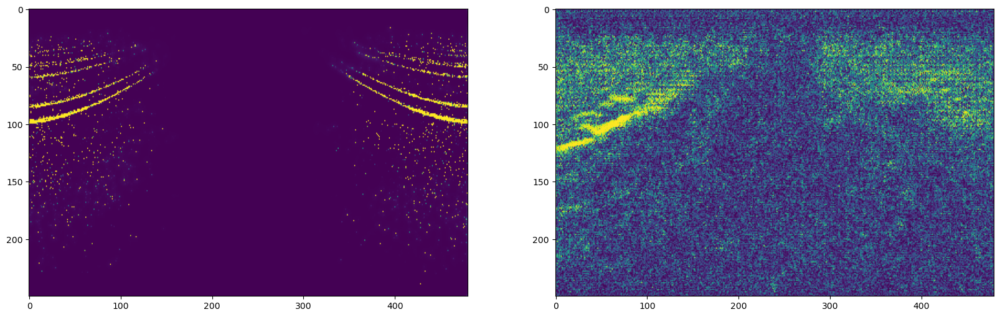

[21]


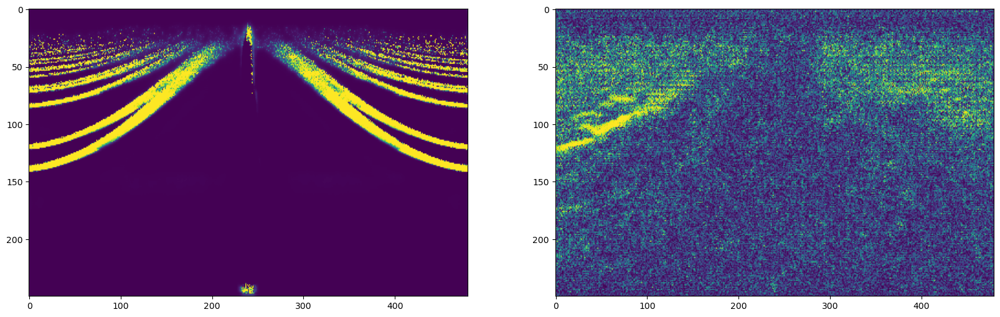

[22]


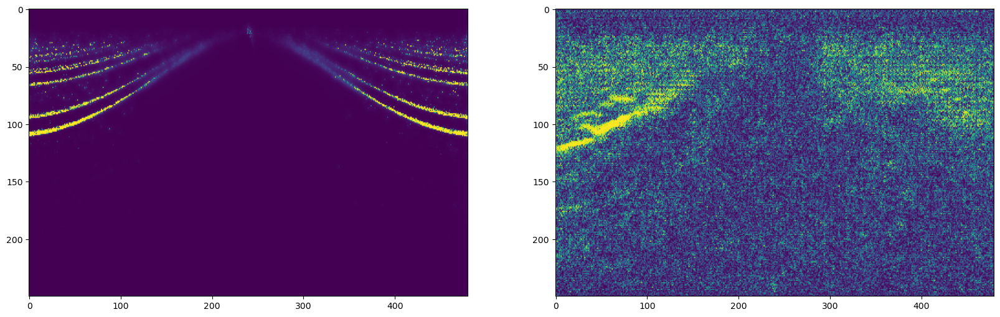

[23]


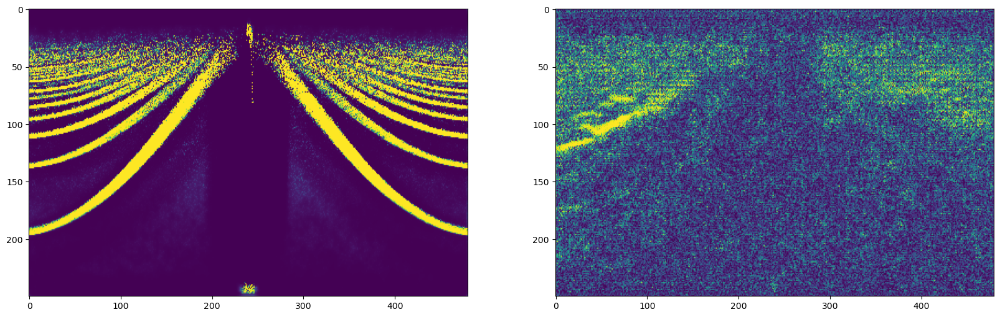

[24]


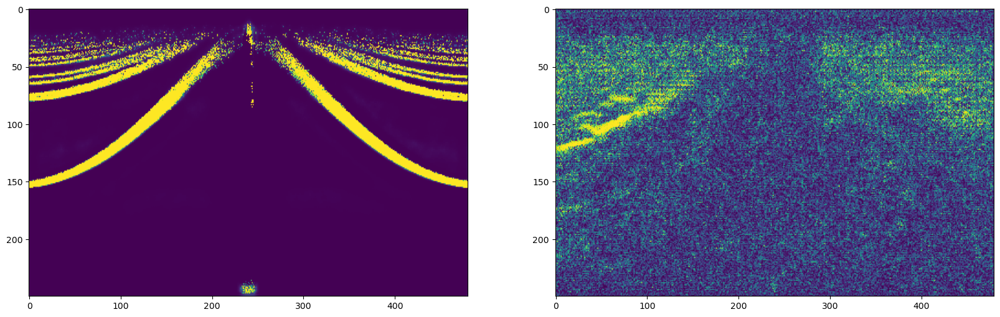

[25]


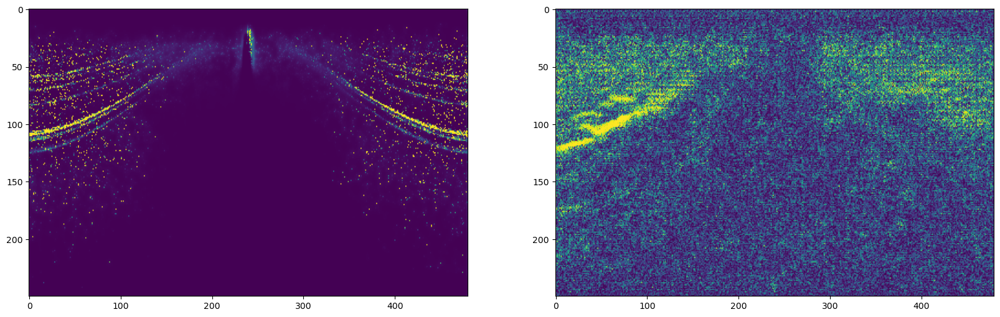

[26]


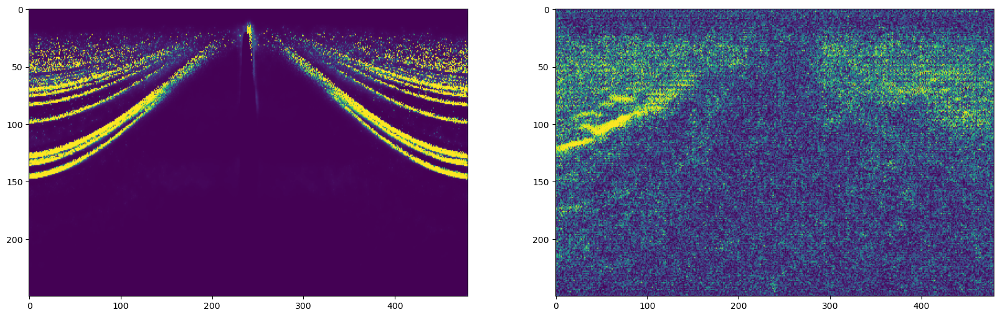

[27]


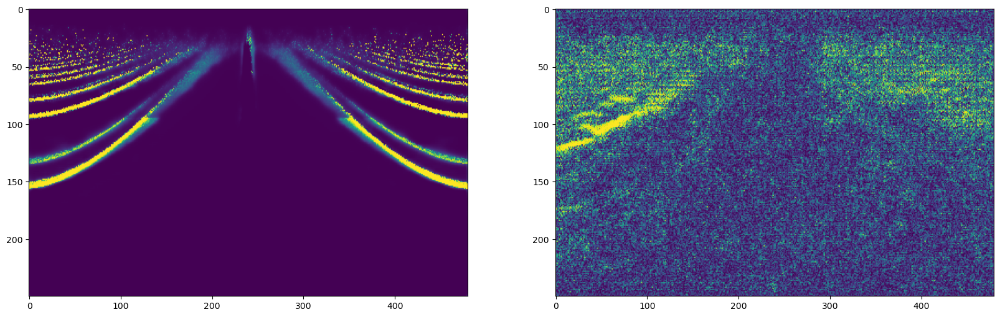

[28]


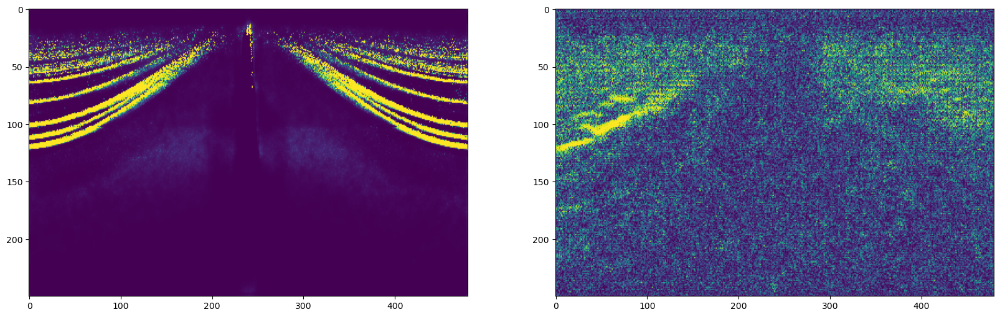

[29]


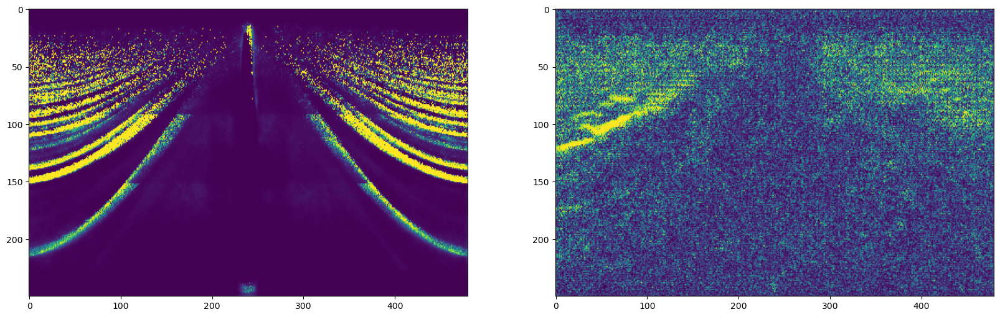

In [79]:
sample_stats = [5.e+08]
sample_stats = torch.FloatTensor(sample_stats)
sample_stats = (sample_stats - mean)/std
sample_stats = sample_stats.unsqueeze(1)  # Преобразует [batch_size] в [batch_size, 1]
sample_stats = sample_stats.to(device)

with torch.no_grad():
    for i in range(len(df_test_tensor)):
        sample_crystal = [i]
        print(sample_crystal)
        sample_crystal = torch.LongTensor(sample_crystal)
        #sample_crystal = sample_crystal.unsqueeze(1)  # Преобразует [batch_size] в [batch_size, 1]
        sample_crystal = sample_crystal.to(device)
        noise = torch.randn(sample_crystal.size(0), noise_dim).to(device)
        fake_images = generator(noise, sample_crystal, sample_stats)

        # Создаем фигуру и оси
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 6))

        # Первый график
        ax1.imshow(df_test_tensor[i][0].cpu().numpy(), cmap='viridis', aspect='auto')

        # Первый график
        ax2.imshow(abs(fake_images[0][0].cpu().numpy()), cmap='viridis', aspect='auto')

        plt.show()